# Assignment 2

* Zeynep Türkmen - 29541

## Importing the common libraries

In [68]:
# the general stuff for all questions
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
%matplotlib inline
from matplotlib import pyplot as plt
import pylab
import math

## Implementation of common functions: erosion and dilation

In [69]:
def dilation_operation(image, SE_size):
    # Creating the structuring element
    SE = np.ones((SE_size, SE_size))

    row, col = image.shape
    offset = SE_size // 2  # Offset of the kernel aka range of pixels to iterate over

    output = np.copy(image)  # Create a copy to modify

    for y in range(offset, row - offset):
        for x in range(offset, col - offset):
            max_value = 0
            # Loop through the neighbors of the current pixel
            for y_SE in range(-offset, offset + 1):
                for x_SE in range(-offset, offset + 1):
                    # SE simply fits here
                    # TODO: for future me add an if check to see if SE has 1 in this index and apply the following accordingly (cross SE stuff)
                    # TODO: can be made efficient if I store some stuff instead of checking over and over but oh well no timeee
                    # I can also add the reflection padding to make it fancier but no time
                    # Get the maximum of the neighbors for dilation
                    max_value = max(max_value, image[y + y_SE, x + x_SE])

            # Replace the pixel with its maximum neighbor value
            output[y, x] = max_value

    return output

In [70]:
def erosion_operation(image, SE_size):
  #creating the structuring element
  SE = np.ones((SE_size, SE_size))

  row, col = image.shape
  offset = SE_size // 2 #offset of the kernel aka range of pixels to iterate over

  output = np.copy(image) #create a copy to modify

  for y in range(offset, row - offset):
    for x in range(offset, col - offset):
      min_value = 255
      #loop through the neighbours of the current pixel
      for y_SE in range(-offset, offset + 1):
        for x_SE in range(-offset, offset + 1):
          #SE simply fits here
          #TODO: for future me add an if check to see if SE has 1 in this index and apply the following accordingly (cross SE stuff)
          #I can also add the reflection padding to make it fancier but no time
          #get the minimum of the neighbours for erosion
          min_value = min(min_value, image[y + y_SE, x + x_SE])

          #replace the pixel with its minimum neighbour value
      output[y, x] = min_value
  return output


## Question 1

1) You have been given a grayscale digital image (q1...jpg). Your objective is to colorize it with pseudo-colors, in such a way that dark areas appear purple, and bright areas appear bright orange. You are free to select/design any non-linear functions (for converting graylevels to color) you desire, as long as they provide the aforementioned appearance and they are derivable in their definition domain. Provide the graphical plots of the red(p), green(p) and blue(p) functions you use for colorization and their definitions; (p stands for the grayscale pixel value), as well as the colorized image. (10 points).


### Retrieving the image

In [ ]:
!wget --no-check-certificate https://drive.google.com/uc?id=11y2JDQy44I8MOv964P0mqjXKlvtt-F29 -O q1.png

--2023-12-16 09:11:47--  https://drive.google.com/uc?id=11y2JDQy44I8MOv964P0mqjXKlvtt-F29
Resolving drive.google.com (drive.google.com)... 142.250.141.113, 142.250.141.138, 142.250.141.102, ...
Connecting to drive.google.com (drive.google.com)|142.250.141.113|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-00-ao-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/8rgo7u69eabrqkaqdnq377di2165s19v/1702717875000/00356598981331114075/*/11y2JDQy44I8MOv964P0mqjXKlvtt-F29?uuid=f336755d-2acd-4eb5-9bfc-e953605fa18b [following]
--2023-12-16 09:11:48--  https://doc-00-ao-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/8rgo7u69eabrqkaqdnq377di2165s19v/1702717875000/00356598981331114075/*/11y2JDQy44I8MOv964P0mqjXKlvtt-F29?uuid=f336755d-2acd-4eb5-9bfc-e953605fa18b
Resolving doc-00-ao-docs.googleusercontent.com (doc-00-ao-docs.googleusercontent.com)... 142.251.2.132, 2607:f8b0:4023:c0d::84
Connecting to doc

Image height= 1038 px, and width= 564 px


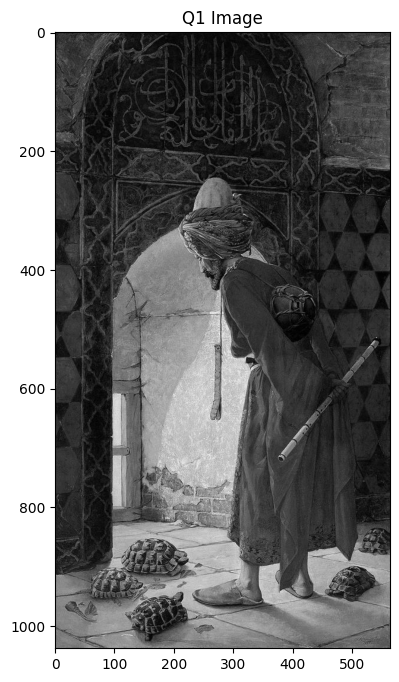

In [ ]:
#reading the image
q1_image = cv2.imread('q1.png',cv2.IMREAD_GRAYSCALE)
height, width = q1_image.shape
print("Image height=", height, "px, and width=", width, "px")

# displaying the image before the operations
pylab.rcParams['figure.figsize'] = (10.0, 8.0) # adjust figure sizes
plt.title("Q1 Image")
plt.imshow(q1_image, cmap='gray')

### Defining and displaying the color functions

#### Color transformations

In [ ]:
#defining the colors I picked for purple and orange
purple = [75, 0, 130] #indigo cuz it looks better
orange = [255, 165, 0]

In [ ]:
#transformation functions for all channels

def apply_red_channel(p):
  #scaling the input to be suitable for the radial transformation
  radial_p = p * math.pi / (2 * 255)
  #getting the corresponding sin value
  sin_p = math.sin(radial_p)
  #making the the output range from purples red channel value to oranges red channel value
  output = purple[0] + sin_p * (orange[0]-purple[0])
  return output

def apply_green_channel(p):
  radial_p = p * math.pi / (2 * 255)
  sin_p = math.sin(radial_p)
  output = purple[1] + sin_p * (orange[1]-purple[1])
  return output

def apply_blue_channel(p):
  radial_p = p * math.pi / (2 * 255)
  #I decided to use cos function for this one simply for aesthetic purposes, otherwise the image becomes orange 'heavy'
  cos_p = math.cos(radial_p)
  output = orange[2] - cos_p * (orange[2]-purple[2])
  return output

#### Visualizations

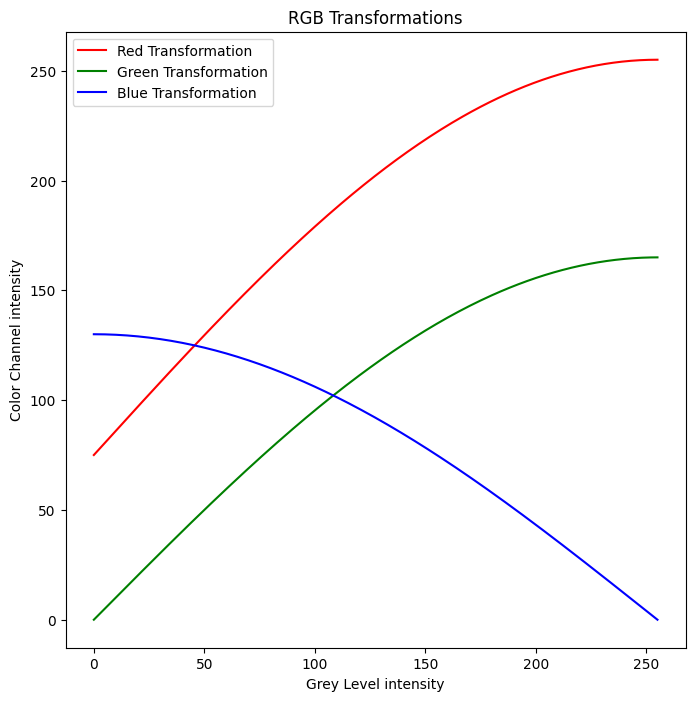

In [ ]:
plt.figure(figsize=(8, 8))

#apply the transformations for all intensity range to visualize
plt.plot(np.arange(256), [apply_red_channel(i) for i in range(256)], color='red', label='Red Transformation')
plt.plot(np.arange(256), [apply_green_channel(i) for i in range(256)], color='green', label='Green Transformation')
plt.plot(np.arange(256), [apply_blue_channel(i) for i in range(256)], color='blue', label='Blue Transformation')

plt.legend()
plt.title('RGB Transformations')
plt.xlabel('Grey Level intensity')
plt.ylabel('Color Channel intensity')
plt.show()

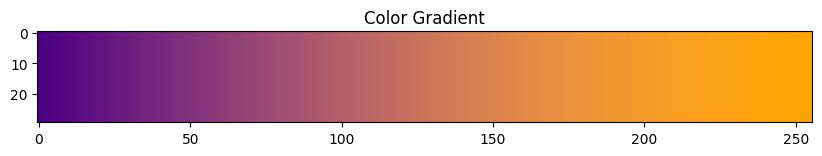

In [ ]:
#this is to display the gradient the functions create, aka all the colors that will be used for all the intensity values

#creating a dummy image of all intensity ranges with 30px width to see it better
dummy_image = np.repeat(np.arange(256, dtype=np.uint8).reshape((1, -1)), 30, axis=0)

#applying the pseudocolors
red_gradient = np.vectorize(apply_red_channel)(dummy_image)
green_gradient = np.vectorize(apply_green_channel)(dummy_image)
blue_gradient = np.vectorize(apply_blue_channel)(dummy_image)

#stacking the values together to get a uniform image
color_gradient = np.stack((red_gradient, green_gradient, blue_gradient), axis=-1)
#normalizing the values to display them
color_gradient = color_gradient / 255.0

plt.title("Color Gradient")
plt.imshow(color_gradient)

### Applying the operation & displaying the results

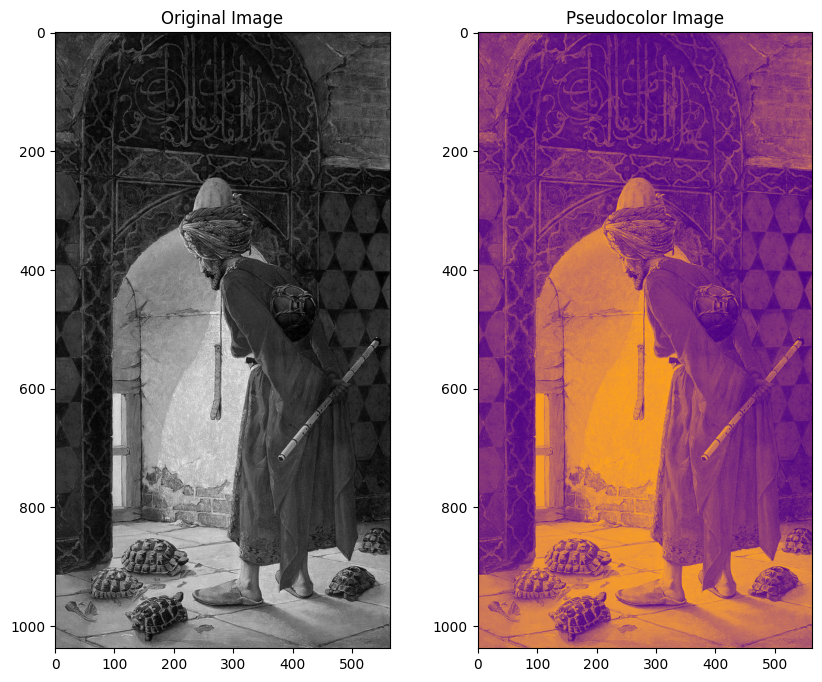

In [ ]:
#applying & stacking the colors
red_channel = np.vectorize(apply_red_channel)(q1_image)
green_channel = np.vectorize(apply_green_channel)(q1_image)
blue_channel = np.vectorize(apply_blue_channel)(q1_image)

q1_image_colorized = np.stack((red_channel, green_channel, blue_channel), axis=-1)
q1_image_colorized = q1_image_colorized / 255.0

#display the results side by side with the original image
fig, axes = plt.subplots(1, 2, figsize=(10, 8))

#original
axes[0].imshow(q1_image, cmap='gray')
axes[0].set_title('Original Image')

#modified
axes[1].imshow(q1_image_colorized)
axes[1].set_title('Pseudocolor Image')

plt.show()

## Question 2

2) Implement the morphological hole filling technique shown in class, and apply it to the provided image (q2..png). (10 points)

### Retrieving the image

In [ ]:
!wget --no-check-certificate https://drive.google.com/uc?id=1Jo8zO06F2dDnK4lnauJvgnYBirhnWeok -O q2.png

--2023-12-16 09:11:57--  https://drive.google.com/uc?id=1Jo8zO06F2dDnK4lnauJvgnYBirhnWeok
Resolving drive.google.com (drive.google.com)... 142.250.141.113, 142.250.141.138, 142.250.141.102, ...
Connecting to drive.google.com (drive.google.com)|142.250.141.113|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-0g-ao-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/057hus876p92p6nfsprbb7eev7jm2v00/1702717875000/00356598981331114075/*/1Jo8zO06F2dDnK4lnauJvgnYBirhnWeok?uuid=8d89d2dd-f14e-48cb-a081-eab4641dbd90 [following]
--2023-12-16 09:11:58--  https://doc-0g-ao-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/057hus876p92p6nfsprbb7eev7jm2v00/1702717875000/00356598981331114075/*/1Jo8zO06F2dDnK4lnauJvgnYBirhnWeok?uuid=8d89d2dd-f14e-48cb-a081-eab4641dbd90
Resolving doc-0g-ao-docs.googleusercontent.com (doc-0g-ao-docs.googleusercontent.com)... 142.251.2.132, 2607:f8b0:4023:c0d::84
Connecting to doc

Image height= 166 px, and width= 187 px


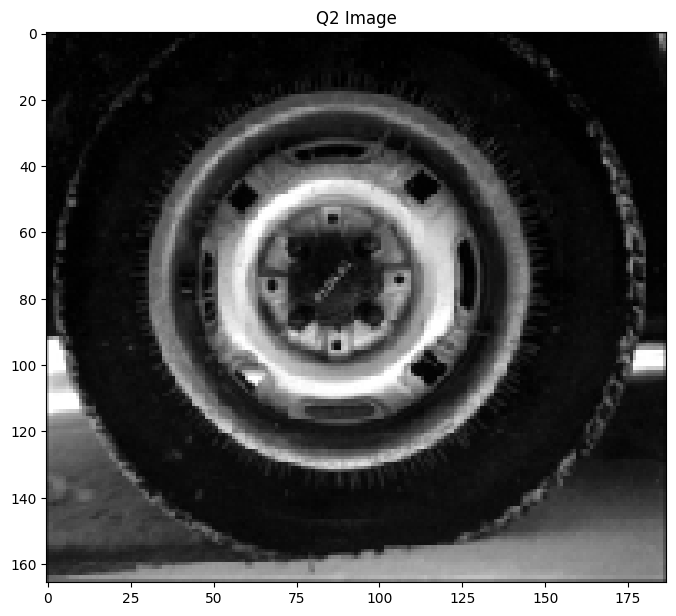

In [ ]:
#reading the image
q2_image = cv2.imread('q2.png',cv2.IMREAD_GRAYSCALE)
height, width = q2_image.shape
print("Image height=", height, "px, and width=", width, "px")

# displaying the image before the operations
pylab.rcParams['figure.figsize'] = (8.0, 8.0) # adjust figure sizes
plt.title("Q2 Image")
plt.imshow(q2_image, cmap='gray')

### Implementing the function

In [ ]:
#threshold input image, fill and apply mask to original input image
#eroded f v g where g is the lowerbound
#loop till idempotence
#do f v g where g is the original function and f is the thresholded thing which is the drawn borders

#TODO: from scipy import ndimage

def greyscale_hole_fill(image):
  #duplicate the input image
  result = np.copy(image)

  #obtain the edges to not pass them during hole filling
  #binarize the image to extract the border by erosion
  binarized = (q2_image > 0).astype(np.uint8) * 255

  #eroded_bool = ndimage.binary_erosion(binarized, np.ones((3, 3)))
  eroded = erosion_operation(binarized, 3)
  #make a mask to apply an arbitrary value to eroded regions
  make_true = (eroded == 255)
  mask = make_true.astype(bool)

  #also make the edges to be false as well to mark the edges of the overall image cuz my function doesnt do any padding
  row, col = mask.shape
  mask[0, :] = mask[row-1, :] = mask[:, 0] = mask[:, col-1] = False


  marker = -5 #arbitrary number smaller than any pixel value

  #set the eroded parts to be an arbitrary marker
  result[mask] = marker

  #now valid values in the borders and arbitrary everywhere else

  #an empty image
  before = np.zeros_like(image)

  #till idempotence loop erode reconstruct
  while np.any(np.not_equal(before, result)):
    before = np.copy(result)

    #erode it but do not go below the original image
    result = np.maximum(image, erosion_operation(result, 3))

  return result

### Applying the operation & displaying the results

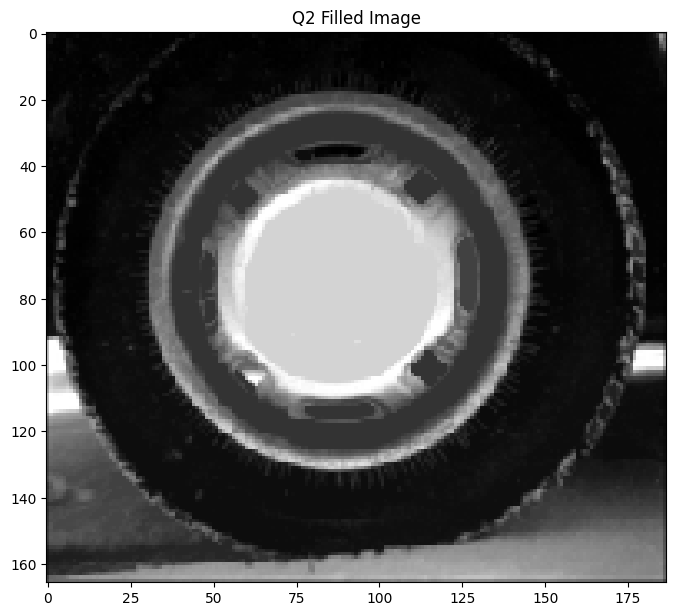

In [ ]:
# displaying the filled image
filled_image = greyscale_hole_fill(q2_image)
pylab.rcParams['figure.figsize'] = (8.0, 8.0) # adjust figure sizes
plt.title("Q2 Filled Image")
plt.imshow(filled_image, cmap='gray')

## Question 3

3) You’ll find attached an aerial image of the city of Pompeii, Italy. It is corrupted with sinusoidal noise due to electrical interference. Examine its Fourier transform and implement an appropriate band reject filter to denoise it (q3..png). (10 points)


### Retrieving the image

In [ ]:
!wget --no-check-certificate https://drive.google.com/uc?id=1mn6BpOBGs2ZGb5Lk5yy83veRV2WoKLFr -O q3.png

--2023-12-16 09:12:19--  https://drive.google.com/uc?id=1mn6BpOBGs2ZGb5Lk5yy83veRV2WoKLFr
Resolving drive.google.com (drive.google.com)... 142.251.2.139, 142.251.2.100, 142.251.2.101, ...
Connecting to drive.google.com (drive.google.com)|142.251.2.139|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-00-ao-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/855jir3udv5of49cofbgep4f81ui401k/1702717875000/00356598981331114075/*/1mn6BpOBGs2ZGb5Lk5yy83veRV2WoKLFr?uuid=68faca16-d520-4346-a692-083babdbfa4c [following]
--2023-12-16 09:12:20--  https://doc-00-ao-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/855jir3udv5of49cofbgep4f81ui401k/1702717875000/00356598981331114075/*/1mn6BpOBGs2ZGb5Lk5yy83veRV2WoKLFr?uuid=68faca16-d520-4346-a692-083babdbfa4c
Resolving doc-00-ao-docs.googleusercontent.com (doc-00-ao-docs.googleusercontent.com)... 142.251.2.132, 2607:f8b0:4023:c0d::84
Connecting to doc-00-ao-d

Image height= 544 px, and width= 900 px


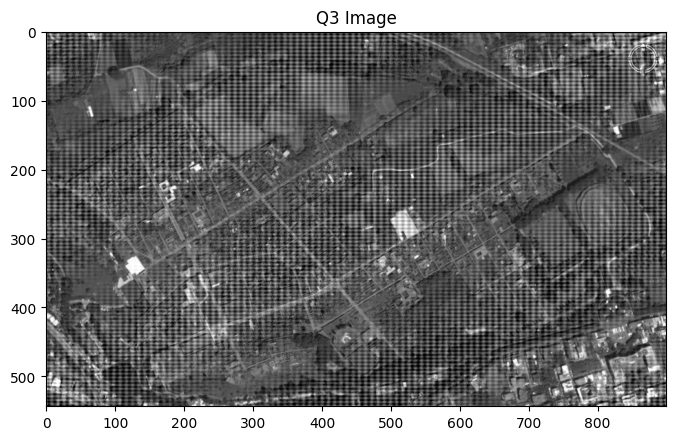

In [ ]:
#reading the image
q3_image = cv2.imread('q3.png',cv2.IMREAD_GRAYSCALE)
height, width = q3_image.shape
print("Image height=", height, "px, and width=", width, "px")

# displaying the image before the operations
pylab.rcParams['figure.figsize'] = (8.0, 8.0) # adjust figure sizes
plt.title("Q3 Image")
plt.imshow(q3_image, cmap='gray')

### Magnitude spectrum operations

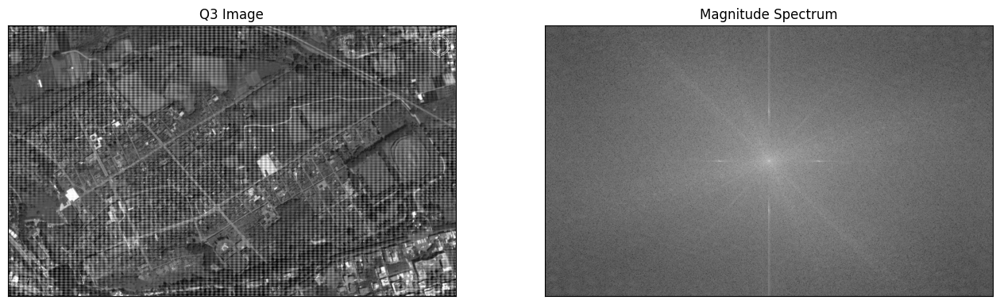

In [ ]:
#apply the fourier transform
fourier = np.fft.fft2(q3_image)

#shift it to the center
fourier = np.fft.fftshift(fourier)

#compute the magnitude spectrum
magnitude_spectrum = 20 * np.log(np.abs(fourier))

pylab.rcParams['figure.figsize'] = (16.0, 16.0) # adjust figure sizes

#display the image along with its magnitude spectrum
plt.subplot(1, 2, 1), plt.imshow(q3_image, cmap='gray')
plt.title('Q3 Image'), plt.xticks([]), plt.yticks([])

plt.subplot(1, 2, 2), plt.imshow(magnitude_spectrum, cmap='gray')
plt.title('Magnitude Spectrum'), plt.xticks([]), plt.yticks([])
plt.show()

### Implementing the band reject filter

In [ ]:
#retrieve the rows & cols to find the center point
row, col = q3_image.shape

#create a mask in the size of the input image
mask = np.zeros((row, col), dtype = np.uint8)

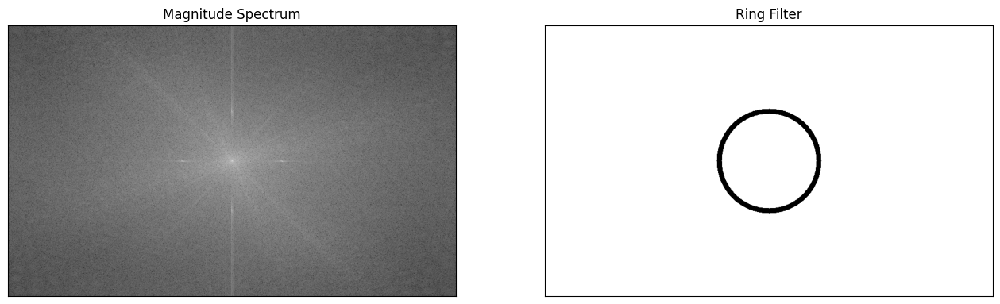

In [ ]:
#find the frequency 'ring' to be 'rejected'
outer = 105
inner = 95

#this is how we create circles, cool
y, x = np.ogrid[:row, :col]

circle_outer = (x - col // 2) ** 2 + (y - row // 2) ** 2 <= outer ** 2
circle_inner = (x - col // 2) ** 2 + (y - row // 2) ** 2 <= inner ** 2

mask[circle_outer] = 255
mask[circle_inner] = 0

mask = ~mask

#display the filter with the image to see it better
plt.subplot(1, 2, 1), plt.imshow(magnitude_spectrum, cmap='gray')
plt.title('Magnitude Spectrum'), plt.xticks([]), plt.yticks([])

plt.subplot(1, 2, 2), plt.imshow(mask, cmap='gray')
plt.title('Ring Filter'), plt.xticks([]), plt.yticks([])
plt.show()

### Applying the operation & displaying the results

In [ ]:
#apply the filter via multiplication(ps.this is freq domain so its cool)
filtered = fourier * mask

#apply inverse fourier to convert back to spatial domain
filtered = np.fft.ifft2(np.fft.ifftshift(filtered)).real

(Text(0.5, 1.0, 'Filtered Image'), ([], []), ([], []))

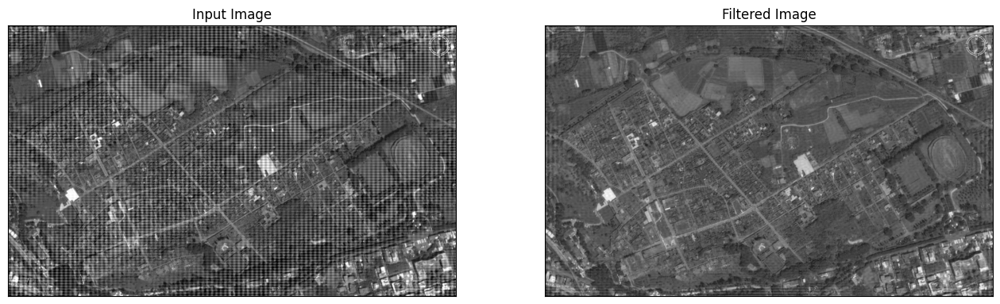

In [ ]:
# Display the results using Matplotlib in a 2x2 grid
plt.subplot(1, 2, 1), plt.imshow(q3_image, cmap='gray')
plt.title('Input Image'), plt.xticks([]), plt.yticks([])

plt.subplot(1, 2, 2), plt.imshow(filtered, cmap='gray')
plt.title('Filtered Image'), plt.xticks([]), plt.yticks([])

## Question 4

4) You have somehow graduated and you now work for a computer vision company (GörüBizimİşimiz A.Ş.); your latest client is a cement production company (BetonRıza A.Ş.). The client Mr. Rıza tells you that their company excavates gravel of only 3 different types from the same site:
123
And they need an effective system to tell them apart automagically. In other words, the final software/system is supposed to take an image of the gravel (with a camera) as input, and guess the gravel type as accurately as possible.
Mr. Rıza provides you with 1 sample image (labeled-1.png, labeled-2.png, labeled-3.png) from each gravel type. And also gives you 1 unlabeled sample from each (unlabeled- A.png, unlabeled-B.png, unlabeled-C.png). Your task is to develop a program that, when it is given as input an unlabeled gravel image, it will print on screen its type (type: 1, 2 or 3).
Upon hearing this, you immediately remember granulometries from that silly image processing course, and how they could be useful for distinguishing one image from the other. You can simply calculate the distance between the resulting numerical granulometry series of an unlabeled image and those of the 3 labeled images, and pick the gravel type closest/most similar to it. But, there are so many questions:
* The objects of interest are sometimes brighter and sometimes darker with respect to their surrounding. Is using opening going to be sufficient?
* What shape/range of sizes of structuring elements should you use?
* Should you use openings/closings or openings/closings by reconstruction?
* As if that wasn’t enough, say you calculate the granulometry of an unlabeled image, how are you supposed to compare the resulting numerical series against the granulometry of a labeled image? Should you rely on the Euclidean distance ? Or their Manhattan distance? Or Chebyshev distance? Or something entirely different?
Design and implement a solution for this problem based on granulometries and answer the aforementioned questions (a to d) with thorough qualitative and/or quantitative justifications. (35 points)

### Retrieving the Images

In [ ]:
!wget --no-check-certificate https://drive.google.com/uc?id=18P3B5jbCd2s9py0iqfypP5IiBDseoN36 -O labeled-1.png
!wget --no-check-certificate https://drive.google.com/uc?id=1o7rZxD0IfHfzoAR0tk5WDZS1qQCR4qSS -O labeled-2.png
!wget --no-check-certificate https://drive.google.com/uc?id=1kOiVzfT7P-LUL489pCiL9fhikDAgP0LD -O labeled-3.png
!wget --no-check-certificate https://drive.google.com/uc?id=16JhJRI31BMpKd3U5MXg3V7CUOPYXD6pe -O unlabeled-A.png
!wget --no-check-certificate https://drive.google.com/uc?id=1uZ1fQVPMU3NX19qpXp1LWjoGadBt2DOF -O unlabeled-B.png
!wget --no-check-certificate https://drive.google.com/uc?id=1NJEsGZ7k-HoeGCiMR1zpjHjoTUsuBeQj -O unlabeled-C.png

--2023-12-16 09:20:15--  https://drive.google.com/uc?id=18P3B5jbCd2s9py0iqfypP5IiBDseoN36
Resolving drive.google.com (drive.google.com)... 142.250.141.101, 142.250.141.138, 142.250.141.100, ...
Connecting to drive.google.com (drive.google.com)|142.250.141.101|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-08-ao-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/2lidekuef40mum496l9qntebmu1le7pe/1702718400000/00356598981331114075/*/18P3B5jbCd2s9py0iqfypP5IiBDseoN36?uuid=bad5925a-3f8b-4e33-83b1-209ab8c8bc18 [following]
--2023-12-16 09:20:15--  https://doc-08-ao-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/2lidekuef40mum496l9qntebmu1le7pe/1702718400000/00356598981331114075/*/18P3B5jbCd2s9py0iqfypP5IiBDseoN36?uuid=bad5925a-3f8b-4e33-83b1-209ab8c8bc18
Resolving doc-08-ao-docs.googleusercontent.com (doc-08-ao-docs.googleusercontent.com)... 142.251.2.132, 2607:f8b0:4023:c0d::84
Connecting to doc

In [ ]:
#reading the images into arrays
labeled_images = {
  '1': cv2.imread('labeled-1.png', cv2.IMREAD_GRAYSCALE),
  '2': cv2.imread('labeled-2.png', cv2.IMREAD_GRAYSCALE),
  '3': cv2.imread('labeled-3.png', cv2.IMREAD_GRAYSCALE),
}

unlabeled_images = {
  'A': cv2.imread('unlabeled-A.png', cv2.IMREAD_GRAYSCALE),
  'B': cv2.imread('unlabeled-B.png', cv2.IMREAD_GRAYSCALE),
  'C': cv2.imread('unlabeled-C.png', cv2.IMREAD_GRAYSCALE),
}

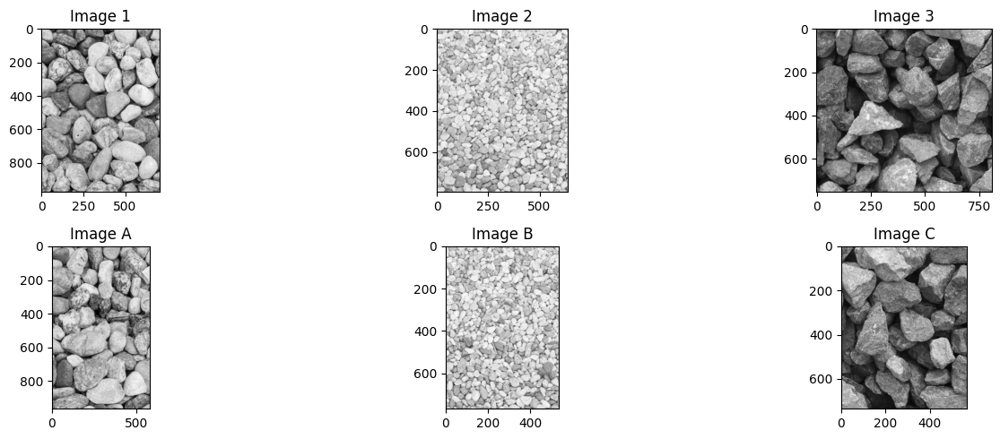

In [ ]:
#displaying the images
images_to_display = [labeled_images[key] for key in ['1', '2', '3']]

plt.figure(figsize=(15, 5))

for i in range(3):
  plt.subplot(2, 3, i+1)
  plt.imshow(images_to_display[i], cmap='gray')
  plt.title(f'Image {i+1}')

images_to_display2 = [unlabeled_images[key] for key in ['A', 'B', 'C']]

for i in range(3):
  plt.subplot(2, 3, i + 4)
  plt.imshow(images_to_display2[i], cmap='gray')
  plt.title(f'Image {chr(ord("A") + i)}')

plt.tight_layout()
plt.show()

### Implementing the granulometry

In [ ]:
def opening_operation(image, SE_size):
  output = erosion_operation(image,SE_size)
  result = dilation_operation(output, SE_size)
  return result

In [ ]:
def get_granulometry(image):
  #the effect of 7 different kernels will be calculated by openings
  output = np.zeros(8, dtype=int) #apply 8 different kernels

  for i in range(8):
    #perform opening on the image using the SE
    opened_image = opening_operation(image, i * 5)

    #calculate the total intensity in the 'opened' image
    output[i] = (np.sum(opened_image))

    if i != 0: #for values other than zero
      output[i - 1] = output[i - 1] - output[i] #take the difference to isolate the effects of a single SE in comparison to others
    #return an array full of intensity variation effects of different structuring elements
  return output

In [ ]:
def euclidean_distance(vec1, vec2):
  return sum((x - y) ** 2 for x, y in zip(vec1, vec2)) ** 0.5

### Applying & displaying the results

In [ ]:
#store the corresponding granulometry results of each label
granulometry_labeled = {}
for label, image in labeled_images.items():
  granulometry_labeled[label] = get_granulometry(image)

#classification of unlabeled ones
for label, image in unlabeled_images.items():
  #retrieve the granulometry of the unlabeled image
  granulometry = get_granulometry(image)

  #compare and match
  current_label = None
  min_distance = float('inf') #minimum distance found so far

  for category, labeled in granulometry_labeled.items():
    #calculate the distance of it to the labeled one and loop all till I find the best one
    current_distance = euclidean_distance(granulometry, labeled)

    if current_distance < min_distance:
      current_label  = category
      min_distance = current_distance

  print(f"{label} is classified as {current_label}")

A is classified as 1
B is classified as 2
C is classified as 3


## Question 5

5) Implement median filtering with the marginal strategy and vector strategy (using lexicographical ordering, bitmix ordering, and norm based ordering).
Perform median filtering using the aforementioned 4 versions, on at least 10 different color 24bit RGB images corrupted with various levels of salt and pepper noise. Report your findings in terms of MSE.
* Which one filters the image best, and by how much?
* Does their relative performance depend on the image?
* Or on the level/correlation of noise?
* What about the effect of the filter size?
* What about the effect of the color space?
Answer all questions and discuss your findings. (35 points)

### Retrieving the images

In [ ]:
!wget --no-check-certificate https://drive.google.com/uc?id=1oCQPEdra5o1r4cnu0kHE_H9b5Ml0HZ9z -O image-1.png
!wget --no-check-certificate https://drive.google.com/uc?id=16vts011qJ3FqvyruNTx6x5i9jVUuJCcR -O image-2.png
!wget --no-check-certificate https://drive.google.com/uc?id=1CdL6Db7lJaex8aP66vhhe1MlxortZRqT -O image-3.png
!wget --no-check-certificate https://drive.google.com/uc?id=1csTLBKU1-krxnrwfM11hn7XYnU_VdPAQ -O image-4.png
!wget --no-check-certificate https://drive.google.com/uc?id=1ILtH9P0L9MoCSVsPcZ6dn1NDDuqYFsWn -O image-5.png
!wget --no-check-certificate https://drive.google.com/uc?id=147fL1bXhimZ4hwSwYMFS_qaGhXR35LpT -O image-6.png
!wget --no-check-certificate https://drive.google.com/uc?id=1Ppa7kp0TU6Tb1JB0A0Lw-VZX8y12YNMo -O image-7.png
!wget --no-check-certificate https://drive.google.com/uc?id=1k0_nriihkSKTUixvtZDEBp0MVKfPuHjA -O image-8.png
!wget --no-check-certificate https://drive.google.com/uc?id=1nx_u39cfQBqAAl8-oT4sul_JnQ1R7kXb -O image-9.png
!wget --no-check-certificate https://drive.google.com/uc?id=1m59GXggvT35XN4ubRXePAO67syU4A6OQ -O image-10.png

--2023-12-17 09:57:09--  https://drive.google.com/uc?id=1oCQPEdra5o1r4cnu0kHE_H9b5Ml0HZ9z
Resolving drive.google.com (drive.google.com)... 173.194.196.102, 173.194.196.139, 173.194.196.100, ...
Connecting to drive.google.com (drive.google.com)|173.194.196.102|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-04-ao-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/6qr8ocs696o048h6k2a4qq9kcfpdr5nb/1702806975000/00356598981331114075/*/1oCQPEdra5o1r4cnu0kHE_H9b5Ml0HZ9z?uuid=dff61adf-47dc-4ebd-8fd6-355f921d4a61 [following]
--2023-12-17 09:57:09--  https://doc-04-ao-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/6qr8ocs696o048h6k2a4qq9kcfpdr5nb/1702806975000/00356598981331114075/*/1oCQPEdra5o1r4cnu0kHE_H9b5Ml0HZ9z?uuid=dff61adf-47dc-4ebd-8fd6-355f921d4a61
Resolving doc-04-ao-docs.googleusercontent.com (doc-04-ao-docs.googleusercontent.com)... 172.253.119.132, 2607:f8b0:4001:c23::84
Connecting to d

In [ ]:
#create a list of all the imported images RGB
image_list = []

for i in range(1, 11):
  img = cv2.imread(f'image-{i}.png')[...,::-1]#to store the colors as RGB
  image_list.append(img/255.0) #normalize them

In [ ]:
image_list_hsv = []

for i in range(1, 11):
  img = cv2.imread(f'image-{i}.png')
  img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

  img_hsv = img_hsv / np.array([179.0, 255.0, 255.0])
  image_list_hsv.append(img_hsv)

### Displaying the images before the operations

In [ ]:
def display_images(image_list, row=2, col=5):
  img_count = len(image_list)

  #creating the subplots 5 by 2
  fig, axes = plt.subplots(row, col, figsize=(15, 7))
  axes = axes.flatten()

  #open all images and d
  for i in range(img_count):
    #display the images
    axes[i].imshow(image_list[i])
    axes[i].axis('off')
    axes[i].set_title(f'Image-{i+1}')

  plt.tight_layout()
  plt.show()

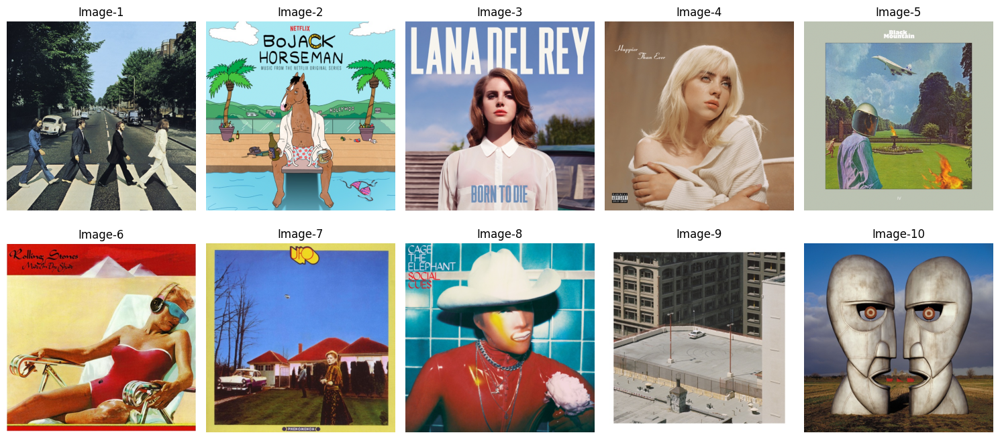

In [ ]:
#display the images before the operations
display_images(image_list)

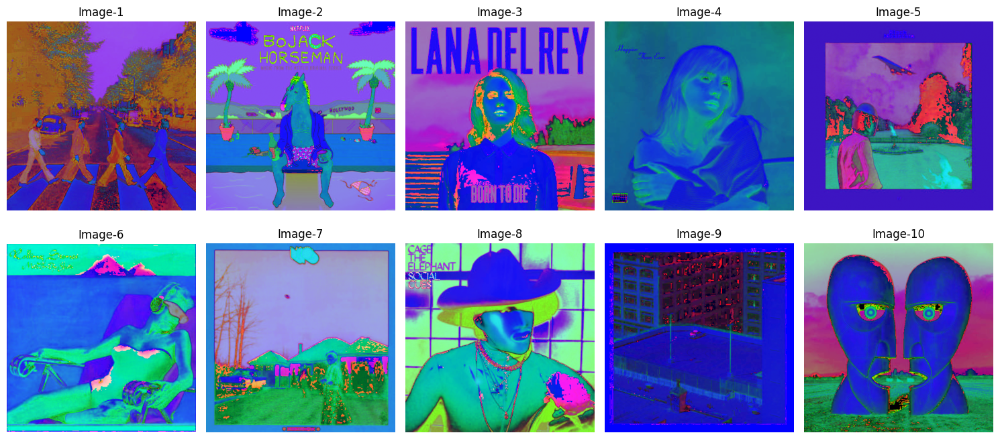

In [ ]:
display_images(image_list_hsv)

### Adding salt & pepper noise

In [ ]:
from skimage.util import random_noise

def add_salt_and_pepper(image_list):
  noise_range = [0.08, 0.14, 0.20, 0.08, 0.14, 0.20, 0.08, 0.14, 0.20, 0.08] #repeated somewhat to see the individual effects of the image itself
  img_count = len(image_list)
  salty_image_list = []

  for i in range(img_count):
    #change the seed so the noise is unique
    salty_image = random_noise(image_list[i], mode='s&p', amount=noise_range[i], seed=i+1)

    #keep it in an array
    salty_image_list.append(salty_image)
  return np.array(salty_image_list, dtype=object)

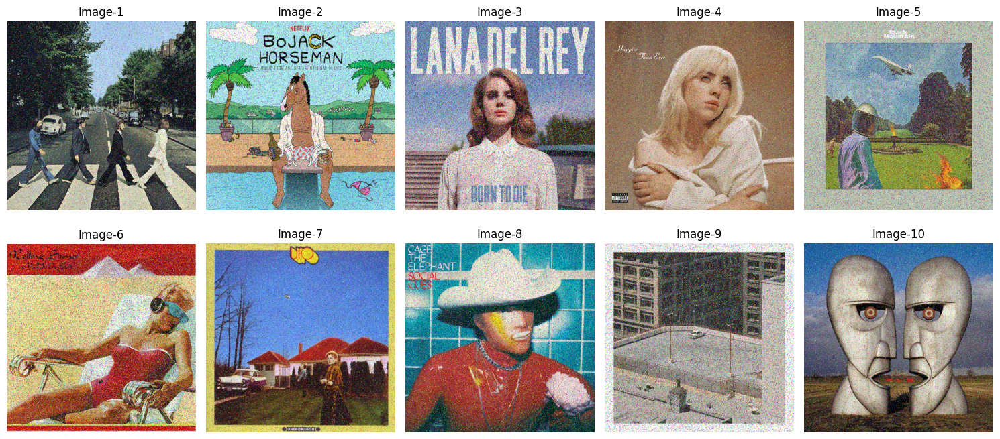

In [ ]:
#get the salted list
salty_images = add_salt_and_pepper(image_list)

#display them
display_images(salty_images)

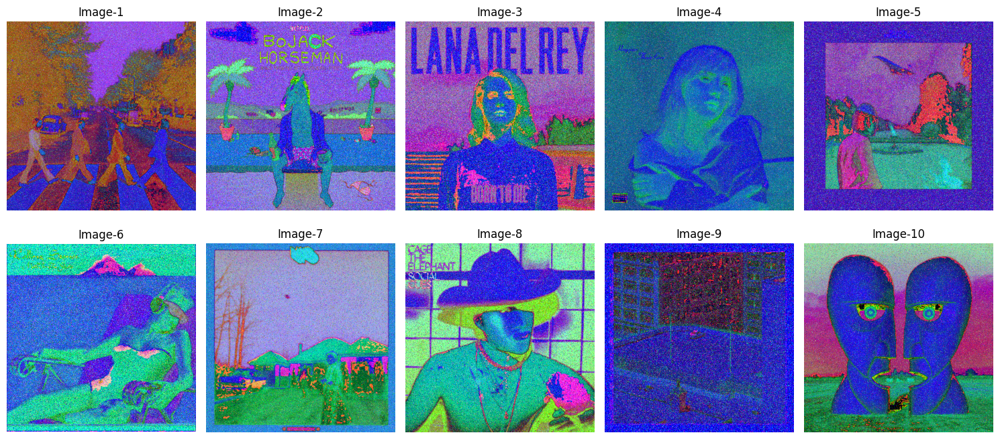

In [ ]:
#get the salted list
salty_images_hsv = add_salt_and_pepper(image_list_hsv)

#display them
display_images(salty_images_hsv)

### MSE function & Median filter function

In [ ]:
from skimage.metrics import mean_squared_error

def get_avg_mse(original_images, filtered_images, filter):
  total = 0
  count = 1

  for original, filtered in zip(original_images, filtered_images):
    mse = mean_squared_error(original, filtered)
    print(f'Image {count}, MSE: {mse}')

    count = count + 1
    total += mse

  avg_mse = total / len(original_images)
  print(f'For {filter}, average MSE is: {avg_mse}')
  return avg_mse

### Median filtering (marginal strategy)

In [ ]:
def apply_median_filter(image, SE_size):
  output_image = np.copy(image)
  offset = SE_size // 2

  #mirror the image according to whether its single or multiple color channels
  if len(image.shape) == 2:
    row, col = image.shape
    mirrored_image = np.pad(image, ((offset, offset), (offset, offset)), mode='reflect')
    #iterate over the image, considering the structuring element size
    for i in range(offset, row + offset):
      for j in range(offset, col + offset):
        # Get the pixels in the structuring element to modify the center
        SE = mirrored_image[i - offset : i + offset + 1, j - offset : j + offset + 1].reshape(-1)
        output_image[i - offset, j - offset] = np.median(SE, axis=None) #current i will correspond to i-off for original cuz we added off to the sides

  elif len(image.shape) == 3:
    row, col, _ = image.shape
    mirrored_image = np.pad(image, ((offset, offset), (offset, offset), (0, 0)), mode='reflect')
    #iterate over the image, considering the structuring element size
    for i in range(offset, row + offset):
      for j in range(offset, col + offset):
        # Get the pixels in the structuring element to modify the center
        SE = mirrored_image[i - offset: i + offset + 1, j - offset: j + offset + 1, :].reshape(-1, 3)#3 for rgb
        col_version = SE.T
        #sort the rows to find the median
        ordered = np.lexsort(col_version)
        output_image[i - offset, j - offset, :] = SE[ordered[len(ordered)//2]]

  return output_image

#### 3x3 SE

In [ ]:
from scipy.ndimage import median_filter

marginal_filtered3 = []

for image in salty_images:
  #apply median to all channels with square structuring element
  median_red = apply_median_filter(image[:, :, 0], 3)
  median_green = apply_median_filter(image[:, :, 1], 3)
  median_blue = apply_median_filter(image[:, :, 2], 3)

  #stack the colors together
  marginal_image = np.stack([median_red, median_green, median_blue], axis=-1)
  #add them to the list
  marginal_filtered3.append(marginal_image)

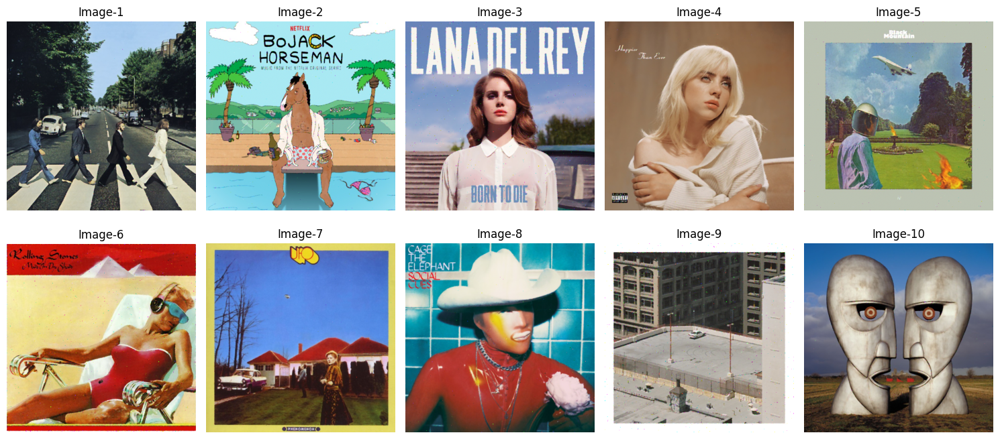

In [ ]:
#displaying the filtered images
display_images(marginal_filtered3)

In [ ]:
#calculating the average MSE
marginal_mse3 = get_avg_mse(image_list, marginal_filtered3, "Marginal Median Filter with SE 3x3")

Image 1, MSE: 0.0026457159497059535
Image 2, MSE: 0.004113235877938682
Image 3, MSE: 0.001251017899098637
Image 4, MSE: 0.00043224346761217187
Image 5, MSE: 0.0012854982698961934
Image 6, MSE: 0.002144726329946521
Image 7, MSE: 0.00038506145784384906
Image 8, MSE: 0.0005305364176171554
Image 9, MSE: 0.0020217575718740654
Image 10, MSE: 0.0005359451350620134
For Marginal Median Filter with SE 3x3, average MSE is: 0.0015345738376595242


#### 3x3 SE for HSV images

In [ ]:
from scipy.ndimage import median_filter

marginal_filtered3_hsv = []

for image in salty_images_hsv:
  #apply median to all channels with square structuring element
  median_red = apply_median_filter(image[:, :, 0], 3)
  median_green = apply_median_filter(image[:, :, 1], 3)
  median_blue = apply_median_filter(image[:, :, 2], 3)

  #stack the colors together
  marginal_image = np.stack([median_red, median_green, median_blue], axis=-1)
  #add them to the list
  marginal_filtered3_hsv.append(marginal_image)

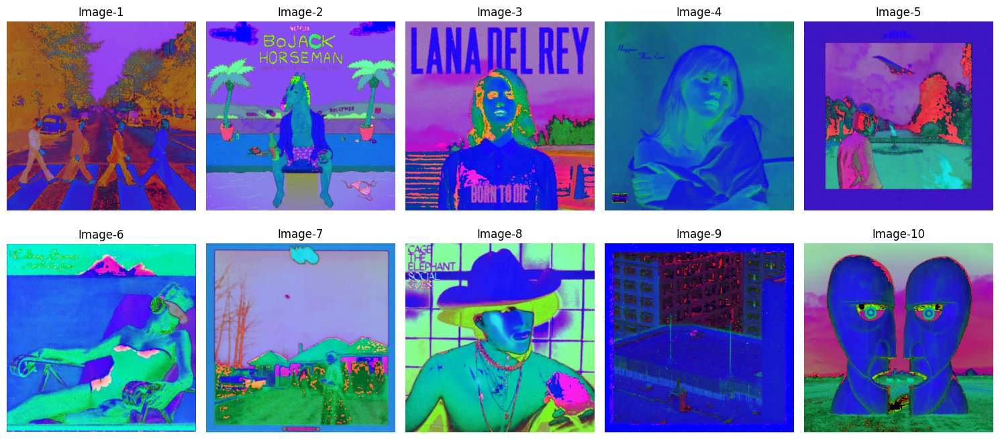

In [ ]:
#displaying the filtered images
display_images(marginal_filtered3_hsv)

In [ ]:
#calculating the average MSE
marginal_mse3_hsv = get_avg_mse(image_list_hsv, marginal_filtered3_hsv, "Marginal Median Filter with SE 3x3 for HSV")

Image 1, MSE: 0.002133355826733573
Image 2, MSE: 0.004255336836298663
Image 3, MSE: 0.005126337007888628
Image 4, MSE: 0.000369858538118879
Image 5, MSE: 0.0020141886303648654
Image 6, MSE: 0.003406570411485136
Image 7, MSE: 0.002611558352050774
Image 8, MSE: 0.0018332115205140576
Image 9, MSE: 0.002865614874687179
Image 10, MSE: 0.002214329313719573
For Marginal Median Filter with SE 3x3 for HSV, average MSE is: 0.0026830361311861325


#### 5x5 SE

In [ ]:
from scipy.ndimage import median_filter

marginal_filtered5 = []

for image in salty_images:
  #apply median to all channels with square structuring element
  median_red = apply_median_filter(image[:, :, 0], 5)
  median_green = apply_median_filter(image[:, :, 1], 5)
  median_blue = apply_median_filter(image[:, :, 2], 5)

  #stack the colors together
  marginal_image = np.stack([median_red, median_green, median_blue], axis=-1)
  #add them to the list
  marginal_filtered5.append(marginal_image)

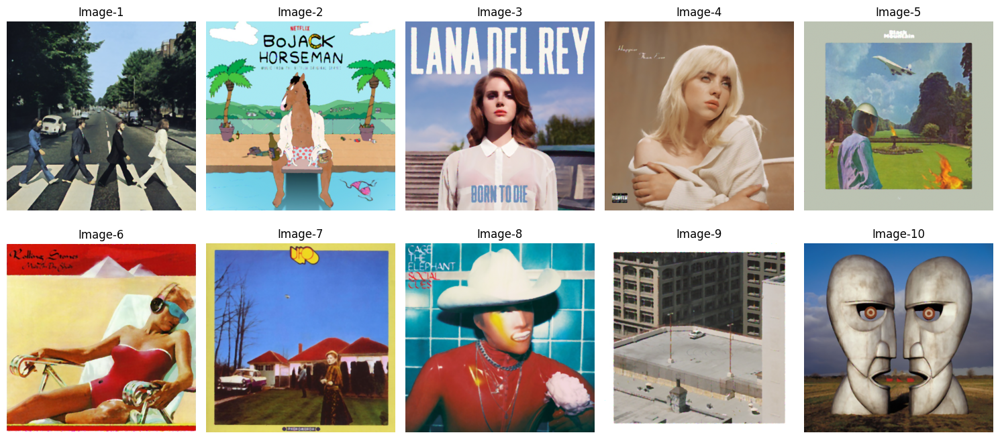

In [ ]:
#displaying the filtered images
display_images(marginal_filtered5)

In [ ]:
#calculating the average MSE
marginal_mse5 = get_avg_mse(image_list, marginal_filtered5, "Marginal Median Filter with SE 5x5")

Image 1, MSE: 0.004773722357497828
Image 2, MSE: 0.007755872541899838
Image 3, MSE: 0.0008535596992609679
Image 4, MSE: 0.0009375282156435563
Image 5, MSE: 0.0018312634741623596
Image 6, MSE: 0.0023907694969611
Image 7, MSE: 0.0010297756560866903
Image 8, MSE: 0.0009902239594457973
Image 9, MSE: 0.002032794836743703
Image 10, MSE: 0.0010179201873923133
For Marginal Median Filter with SE 5x5, average MSE is: 0.0023613430425094154


### Median filtering (vector strategy) - lexicographical ordering

#### 3x3 SE

In [ ]:
lexico_filtered3 = []

for image in salty_images:
  #apply to all channels without seperation
  lexico_image = apply_median_filter(image, 3)
  lexico_filtered3.append(lexico_image)

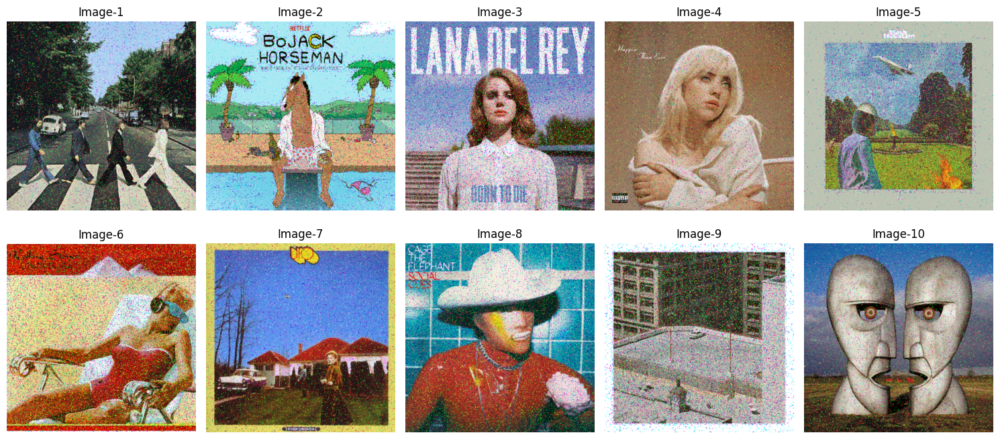

In [ ]:
#displaying the results
display_images(lexico_filtered3)

In [ ]:
#calculating the average MSE
lexico_mse3 = get_avg_mse(image_list, lexico_filtered3, "Lexicographical Ordered Median Filter with 3x3 SE")

Image 1, MSE: 0.02075590271547981
Image 2, MSE: 0.027384466971392765
Image 3, MSE: 0.039638707505660196
Image 4, MSE: 0.013207594201660337
Image 5, MSE: 0.019223811810272398
Image 6, MSE: 0.04996484921906647
Image 7, MSE: 0.016611483247184134
Image 8, MSE: 0.031209138536460342
Image 9, MSE: 0.04069508308770132
Image 10, MSE: 0.015747198100445687
For Lexicographical Ordered Median Filter with 3x3 SE, average MSE is: 0.02744382353953235


#### 3x3 SE for HSV images

In [ ]:
lexico_filtered3_hsv = []

for image in salty_images_hsv:
  #apply to all channels without seperation
  lexico_image = apply_median_filter(image, 3)
  lexico_filtered3_hsv.append(lexico_image)

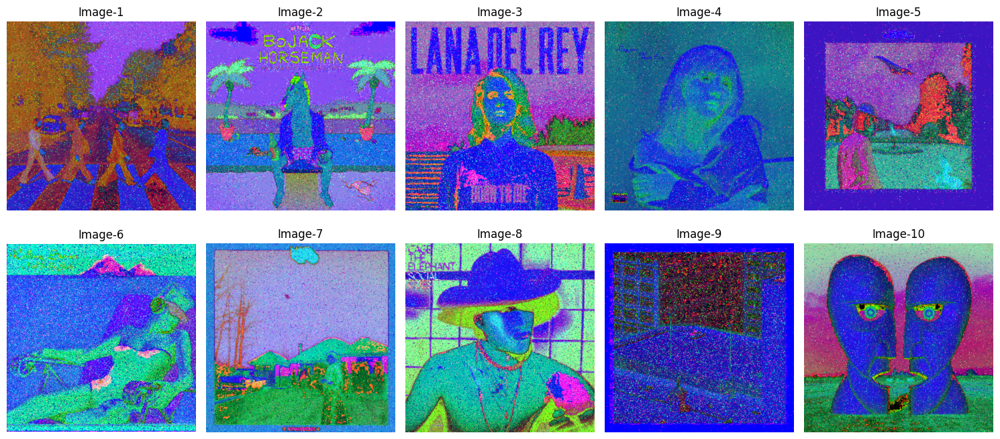

In [ ]:
#displaying the results
display_images(lexico_filtered3_hsv)

In [ ]:
#calculating the average MSE
lexico_mse3_hsv = get_avg_mse(image_list_hsv, lexico_filtered3_hsv, "Lexicographical Ordered Median Filter with 3x3 SE for HSV")

Image 1, MSE: 0.019074400341750765
Image 2, MSE: 0.026714274870145417
Image 3, MSE: 0.0482253093802194
Image 4, MSE: 0.016718106768937445
Image 5, MSE: 0.02379991490387417
Image 6, MSE: 0.05345470753155984
Image 7, MSE: 0.020894293968460563
Image 8, MSE: 0.03418500862255304
Image 9, MSE: 0.047995631816481435
Image 10, MSE: 0.02127816863660719
For Lexicographical Ordered Median Filter with 3x3 SE for HSV, average MSE is: 0.031233981684058925


#### 5x5 SE

In [ ]:
lexico_filtered5 = []

for image in salty_images:
  #apply to all channels without seperation
  lexico_image = apply_median_filter(image, 5)
  lexico_filtered5.append(lexico_image)

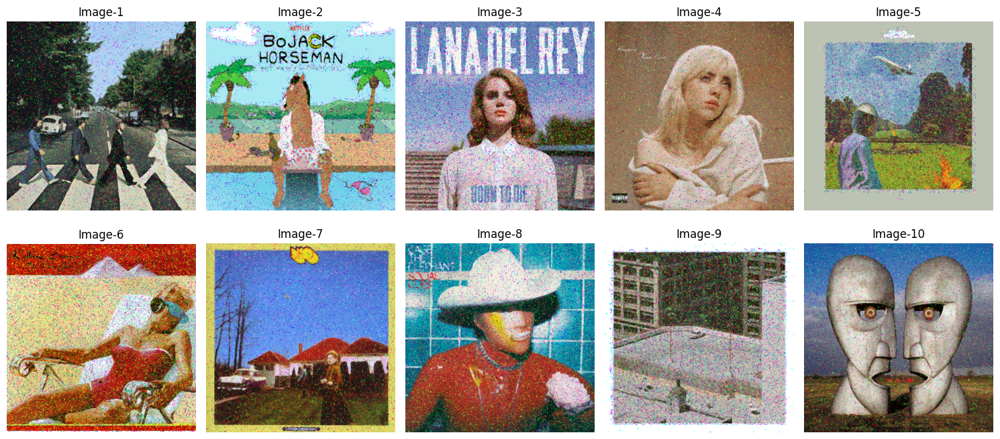

In [ ]:
#displaying the results
display_images(lexico_filtered5)

In [ ]:
#calculating the average MSE
lexico_mse5 = get_avg_mse(image_list, lexico_filtered5, "Lexicographical Ordered Median Filter with 5x5 SE")

Image 1, MSE: 0.023184220470759107
Image 2, MSE: 0.030970528628590135
Image 3, MSE: 0.039740652768878074
Image 4, MSE: 0.014394643555897303
Image 5, MSE: 0.019069547980121608
Image 6, MSE: 0.050904976632345555
Image 7, MSE: 0.017563095120110502
Image 8, MSE: 0.032616668119099496
Image 9, MSE: 0.03906097950930553
Image 10, MSE: 0.016572676748259223
For Lexicographical Ordered Median Filter with 5x5 SE, average MSE is: 0.028407798953336654


### Median filtering (vector strategy) - bitmix ordering

In [ ]:
def order_bitmix(SE, SE_size):
  bit_list = []
  the_range = SE_size * SE_size

  for i in range(the_range):
    #converting the values into binary format
    red_value = format(int(SE[i][0]),'08b')
    green_value = format(int(SE[i][1]),'08b')
    blue_value = format(int(SE[i][2]),'08b')
    concat_value = red_value + green_value + blue_value
    bit_list.append(concat_value)

  #sort the bit array
  bit_list.sort()

  center_item = bit_list[the_range//2] #center element in the ordered list
  #convert the values back to integer 2 based
  #first 8 bits are for red and so fourth
  return (int(center_item[:8], 2), int(center_item[8:16], 2), int(center_item[16:24], 2))

def apply_bitmix_ordering(image, SE_size):
  output_image = np.copy(image)
  row, col, rgb = image.shape

  offset = SE_size//2

  mirrored_image = np.pad(image, ((offset, offset), (offset, offset), (0,0)), mode='reflect')
  #iterate over the image, considering the structuring element size
  for i in range(offset, row + offset):
    for j in range(offset, col + offset):
      # Get the pixels in the structuring element to modify the center
      SE = mirrored_image[i - offset: i + offset + 1, j - offset: j + offset + 1, :].reshape(-1, 3)
      # Calculate the median over the entire 3D neighborhood
      output_image[i - offset, j - offset, :] = order_bitmix(SE, SE_size)
  return output_image


#### 3x3 SE

In [ ]:
bitmix_filtered3 = []

for image in salty_images:
  #make it int for easier bit transformation
  bitmix_image = apply_bitmix_ordering((image * 255), 3)
  #normalize back the values
  bitmix_filtered3.append(bitmix_image/255.0)

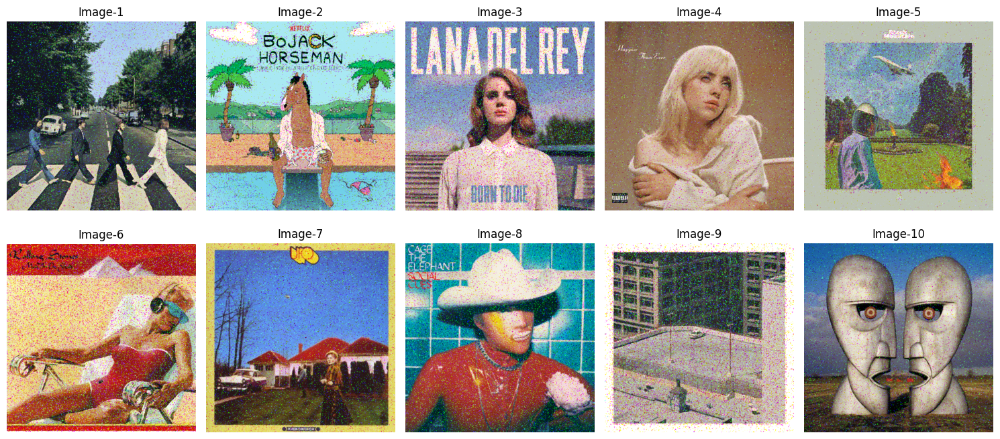

In [ ]:
#displaying the results
display_images(bitmix_filtered3)

In [ ]:
#calculating the average MSE
bitmix_mse3 = get_avg_mse(image_list, bitmix_filtered3, "Bitmix Ordered Median Filter with 3x3 SE")

Image 1, MSE: 0.020461986814188274
Image 2, MSE: 0.02929851211072665
Image 3, MSE: 0.04034429122702097
Image 4, MSE: 0.012952913096102638
Image 5, MSE: 0.02017556869864867
Image 6, MSE: 0.04918173939868822
Image 7, MSE: 0.018095209022170964
Image 8, MSE: 0.029231885941304624
Image 9, MSE: 0.04087644514218177
Image 10, MSE: 0.01565373306563003
For Bitmix Ordered Median Filter with 3x3 SE, average MSE is: 0.02762722845166628


#### 3x3 SE for HSV

In [ ]:
bitmix_filtered3_hsv = []

for image in salty_images_hsv:
  #make it int for easier bit transformation
  bitmix_image = apply_bitmix_ordering((image * np.array([179.0, 255.0, 255.0])), 3)
  #normalize back the values
  bitmix_filtered3_hsv.append(bitmix_image/np.array([179.0, 255.0, 255.0]))

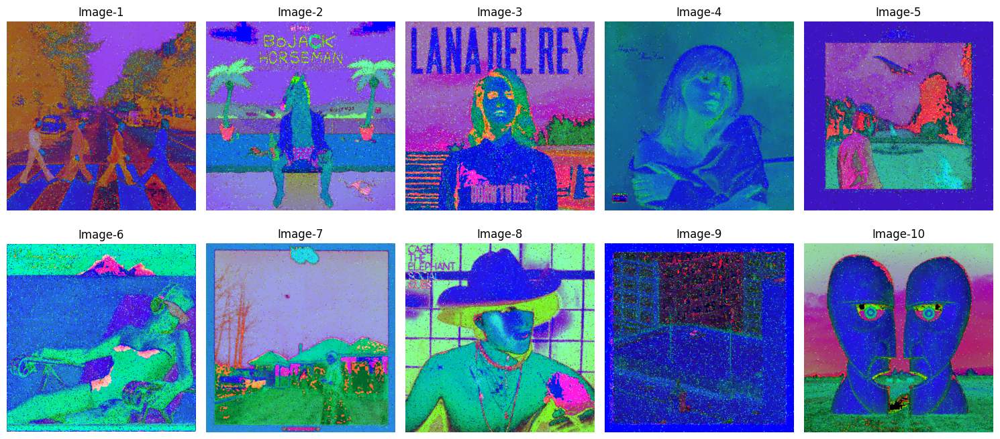

In [ ]:
#displaying the results
display_images(bitmix_filtered3_hsv)

In [ ]:
#calculating the average MSE
bitmix_mse3_hsv = get_avg_mse(image_list_hsv, bitmix_filtered3_hsv, "Bitmix Ordered Median Filter with 3x3 SE for HSV")

Image 1, MSE: 0.01815831868285223
Image 2, MSE: 0.026699651972378585
Image 3, MSE: 0.04083683257150119
Image 4, MSE: 0.009463412048898445
Image 5, MSE: 0.019326093285550894
Image 6, MSE: 0.04189453437305184
Image 7, MSE: 0.015587502896533068
Image 8, MSE: 0.02565768976813349
Image 9, MSE: 0.037847827232312815
Image 10, MSE: 0.015144802556155591
For Bitmix Ordered Median Filter with 3x3 SE for HSV, average MSE is: 0.025061666538736815


#### 5x5 SE

In [ ]:
bitmix_filtered5 = []

for image in salty_images:
  #make it int for easier bit transformation
  bitmix_image = apply_bitmix_ordering((image * 255), 5)
  #normalize back the values
  bitmix_filtered5.append(bitmix_image/255.0)

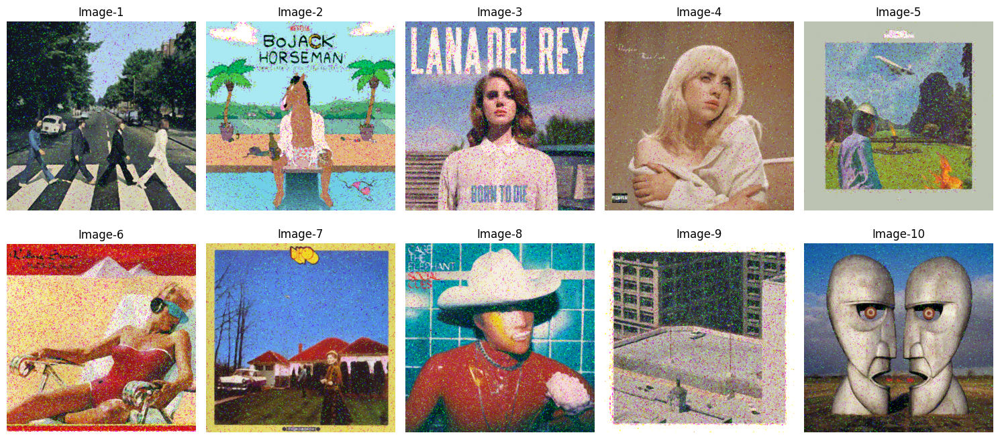

In [ ]:
#displaying the results
display_images(bitmix_filtered5)

In [ ]:
#calculating the average MSE
bitmix_mse5 = get_avg_mse(image_list, bitmix_filtered5, "Bitmix Ordered Median Filter with 5x5 SE")

Image 1, MSE: 0.022713026129551308
Image 2, MSE: 0.03320882884075924
Image 3, MSE: 0.04142747366397541
Image 4, MSE: 0.014322696811767559
Image 5, MSE: 0.019588625799194043
Image 6, MSE: 0.050535697550503286
Image 7, MSE: 0.018966789212126398
Image 8, MSE: 0.030787889273356395
Image 9, MSE: 0.038967519315932606
Image 10, MSE: 0.016660428894869492
For Bitmix Ordered Median Filter with 5x5 SE, average MSE is: 0.02871789754920358


### Median filtering (vector strategy) - norm based ordering

In [ ]:
def order_norm(SE, center, SE_size):
  norm_list = [] #this will store the distance values
  distance_dictionary = {}  # Create an empty dictionary to store distances and corresponding pixels
  the_range = SE_size * SE_size

  for i in range(the_range):
    #calculate the euclidean distance
    distance = math.sqrt(abs(pow((center[0] - SE[i][0]), 2) + pow((center[1] - SE[i][1]), 2) + pow((center[2] - SE[i][2]), 2)))
    norm_list.append((i, distance))

  #sort by distance
  norm_list.sort(key=lambda x: x[1])
  #return the center value
  return SE[norm_list[the_range//2][0]]

def apply_norm_ordering(image, SE_size):
  output_image = np.copy(image)
  row, col, rgb = image.shape

  offset = SE_size//2

  mirrored_image = np.pad(image, ((offset, offset), (offset, offset), (0,0)), mode='reflect')
  #iterate over the image, considering the structuring element size
  for i in range(offset, row + offset):
    for j in range(offset, col + offset):
      # Get the pixels in the structuring element to modify the center
      SE = mirrored_image[i - offset: i + offset + 1, j - offset: j + offset + 1, :].reshape(-1, 3)
      # Calculate the median over the entire 3D neighborhood
      output_image[i - offset, j - offset, :] = order_norm(SE, image[i - offset, j - offset], SE_size)
  return output_image

#### 3x3 SE

In [ ]:
norm_filtered3 = []

for image in salty_images:
  norm_image = apply_norm_ordering((image * 255.0), 3)
  norm_filtered3.append(norm_image / 255.0)

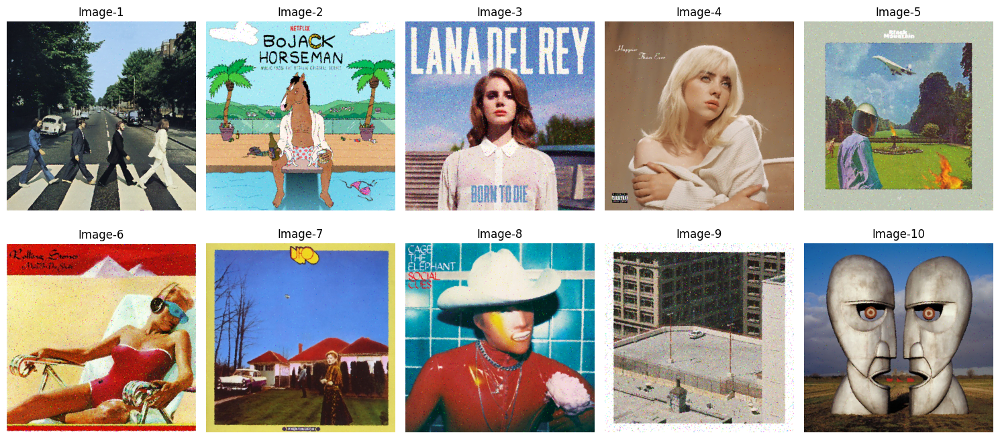

In [ ]:
#displaying the results
display_images(norm_filtered3)

In [ ]:
#calculating the average MSE
norm_mse3 = get_avg_mse(image_list, norm_filtered3, "Norm Ordered Median Filter with 3x3 SE")

Image 1, MSE: 0.006760703917296772
Image 2, MSE: 0.01371698150284079
Image 3, MSE: 0.015966142993435573
Image 4, MSE: 0.0017935823401255921
Image 5, MSE: 0.007719654050436443
Image 6, MSE: 0.015415426723101108
Image 7, MSE: 0.0023748975750067635
Image 8, MSE: 0.005715856693294601
Image 9, MSE: 0.019361974411551113
Image 10, MSE: 0.002331792373303716
For Norm Ordered Median Filter with 3x3 SE, average MSE is: 0.009115701258039248


#### 3x3 SE for HSV image

In [ ]:
norm_filtered3_hsv = []

for image in salty_images_hsv:
  norm_image = apply_norm_ordering((image * np.array([179.0, 255.0, 255.0])), 3)
  norm_filtered3_hsv.append(norm_image / np.array([179.0, 255.0, 255.0]))

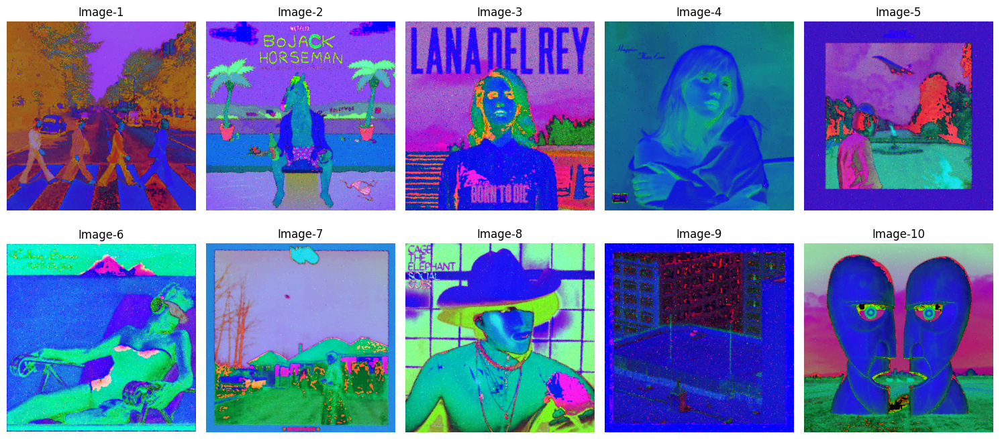

In [ ]:
#displaying the results
display_images(norm_filtered3_hsv)

In [ ]:
#calculating the average MSE
norm_mse3_hsv = get_avg_mse(image_list_hsv, norm_filtered3_hsv, "Norm Ordered Median Filter with 3x3 SE for HSV")

Image 1, MSE: 0.006113818675837344
Image 2, MSE: 0.014090145445912701
Image 3, MSE: 0.021447875556447383
Image 4, MSE: 0.0013234292498388858
Image 5, MSE: 0.008243681261372657
Image 6, MSE: 0.017236481234673886
Image 7, MSE: 0.005362547566575057
Image 8, MSE: 0.008769810781893454
Image 9, MSE: 0.01605753776934351
Image 10, MSE: 0.004904423830367173
For Norm Ordered Median Filter with 3x3 SE for HSV, average MSE is: 0.010354975137226203


#### 5x5 SE

In [ ]:
norm_filtered5 = []

for image in salty_images:
  norm_image = apply_norm_ordering((image * 255.0), 5)
  norm_filtered5.append(norm_image / 255.0)

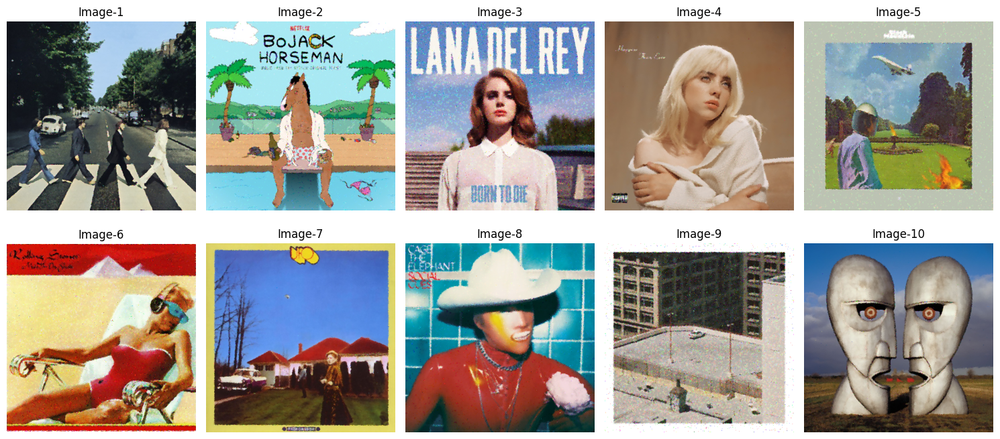

In [ ]:
#displaying the results
display_images(norm_filtered5)

In [ ]:
#calculating the average MSE
norm_mse5 = get_avg_mse(image_list, norm_filtered5, "Norm Ordered Median Filter with 5x5 SE")

Image 1, MSE: 0.009471786905321317
Image 2, MSE: 0.016905902103179684
Image 3, MSE: 0.013592447448986855
Image 4, MSE: 0.0020181598672875107
Image 5, MSE: 0.006696819300269126
Image 6, MSE: 0.013335148458646518
Image 7, MSE: 0.0036211770259301987
Image 8, MSE: 0.005613742364048014
Image 9, MSE: 0.017435246343998744
Image 10, MSE: 0.00297264643228388
For Norm Ordered Median Filter with 5x5 SE, average MSE is: 0.009166307624995188
